## Initialisation

In [1]:
### Installing packages ###
!pip install geopandas
!pip install pygeodesy
!pip install pygeodesic
!pip install pycaret
#!pip install autoviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 990.7/990.7 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 984.3/984.3 kB 6.2 MB/s eta 0:00:00


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import pdb
import time
from google.colab import drive
import statsmodels.formula.api as sma
import statsmodels.api as sm
import geopandas as gpd
from geopy.distance import geodesic
from shapely.geometry import Polygon, MultiPolygon, Point
from sklearn.model_selection import train_test_split, cross_val_score


In [3]:
### Importing libraries ###



#from shapely.geometry import Point
from shapely.geometry import Polygon, MultiPolygon, Point

import folium
from geopy.distance import geodesic

from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import RFE
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.experimental import enable_iterative_imputer
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.inspection import permutation_importance



from scipy.spatial import cKDTree
from scipy.stats import zscore



from pycaret.regression import *

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
# IterativeImputer is experimental and the API might change without any deprecation cycle.

## Data Importation

In [4]:
### Iris Paris ###

drive.mount('/content/drive')
file_path = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/Iris/Clean/data_iris_paris.geojson'
irisparis = gpd.read_file(file_path)
irisparis.head(5)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


,OBJECTID,n_sq_ir,c_cainsee,n_qu,c_ir,c_typeir,l_ir,m2_ip,m2_pop,m2_emp,...,shape_Area,geo_point,dep,insee_com,nom_com,iris,code_iris,nom_iris,typ_iris,geometry
0,20,750004033,75118,69,751186922,H,Grandes Carrières 22,69711.047044,42891.780556,69688.085258,...,80920.786958,"{'lon': 2.33473231093, 'lat': 48.8955334043}",75,75118,Paris 18e Arrondissement,6922,751186922,Grandes Carrieres 22,H,"POLYGON ((2.33756 48.89531, 2.33799 48.89591, ..."
1,21,750004043,75118,69,751186923,H,Grandes Carrières 23,51939.257797,51939.489210,51939.257797,...,68661.340091,"{'lon': 2.3297484576, 'lat': 48.8945094182}",75,75118,Paris 18e Arrondissement,6923,751186923,Grandes Carrieres 23,H,"POLYGON ((2.33262 48.89419, 2.33251 48.89430, ..."
2,22,750004027,75118,69,751186924,H,Grandes Carrières 24,49511.462977,43233.728108,47498.682647,...,73724.514027,"{'lon': 2.3308879204, 'lat': 48.8967235402}",75,75118,Paris 18e Arrondissement,6924,751186924,Grandes Carrieres 24,H,"POLYGON ((2.33297 48.89606, 2.33308 48.89627, ..."
3,23,750004026,75118,69,751186925,H,Grandes Carrières 25,53456.911856,37176.576688,44169.508934,...,81608.212989,"{'lon': 2.33742640417, 'lat': 48.8971849905}",75,75118,Paris 18e Arrondissement,6925,751186925,Grandes Carrieres 25,H,"POLYGON ((2.34229 48.89722, 2.34236 48.89733, ..."
4,24,750004862,75118,69,751186926,H,Grandes Carrières 26,100866.919597,38308.332796,83837.826331,...,176037.028979,"{'lon': 2.34037476455, 'lat': 48.8999631892}",75,75118,Paris 18e Arrondissement,6926,751186926,Grandes Carrieres 26,H,"POLYGON ((2.34416 48.89795, 2.34411 48.89931, ..."


In [5]:
### Immobilier ###

file_path2 = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/Immobilier/Clean/Train/75immo_clean_2022.csv'
apartments = pd.read_csv(file_path2)
apartments.head(5)

,Unnamed: 0,id_mutation,date_mutation,numero_disposition,nature_mutation,valeur_fonciere,adresse_numero,adresse_suffixe,adresse_nom_voie,adresse_code_voie,...,type_local,surface_reelle_bati,nombre_pieces_principales,code_nature_culture,nature_culture,code_nature_culture_speciale,nature_culture_speciale,surface_terrain,longitude,latitude
0,0,2022-1621603,2022-01-06,1,Vente,605000.0,51.0,NaN,RUE CHARLOT,1880,...,Appartement,42.0,3.0,NaN,NaN,NaN,NaN,NaN,2.362871,48.863374
1,1,2022-1621616,2022-01-07,1,Vente,660000.0,141.0,NaN,RUE DES POISSONNIERS,7564,...,Appartement,81.0,3.0,NaN,NaN,NaN,NaN,NaN,2.352517,48.895742
2,2,2022-1621619,2022-01-07,1,Vente,293000.0,7.0,NaN,RUE SAINT-MARC,8686,...,Appartement,22.0,1.0,NaN,NaN,NaN,NaN,NaN,2.341378,48.870214
3,3,2022-1621625,2022-01-05,1,Vente,300000.0,55.0,NaN,RUE STEPHENSON,9092,...,Appartement,38.0,1.0,NaN,NaN,NaN,NaN,NaN,2.355461,48.889540
4,4,2022-1621629,2022-01-05,1,Vente,335000.0,75.0,NaN,AV NIEL,6773,...,Appartement,33.0,2.0,NaN,NaN,NaN,NaN,NaN,2.295735,48.882706


In [6]:
### Amenité ###

file_path3 = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/Amenite/Clean/amenite_geometry.geojson'
amenite = gpd.read_file(file_path3)
amenite.head(5)

,ide,longitude,latitude,geometry
0,terrasses-autorisations_0,2.337336,48.879644,POINT (2.33734 48.87964)
1,terrasses-autorisations_1,2.313040,48.831376,POINT (2.31304 48.83138)
2,terrasses-autorisations_2,2.342332,48.856313,POINT (2.34233 48.85631)
3,terrasses-autorisations_3,2.342860,48.892071,POINT (2.34286 48.89207)
4,terrasses-autorisations_4,2.368621,48.854266,POINT (2.36862 48.85427)


In [7]:
### Immobilier Geometry ###

file_path4 = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/Immobilier/Clean/Train/immo_geometry.geojson'
immobilier = gpd.read_file(file_path4)
immobilier.head(5)

,id_mutation,longitude,latitude,geometry
0,2018-743589,2.337476,48.866524,POINT (2.33748 48.86652)
1,2018-743594,2.310473,48.870036,POINT (2.31047 48.87004)
2,2018-743596,2.352721,48.864270,POINT (2.35272 48.86427)
3,2018-743597,2.358997,48.863836,POINT (2.35900 48.86384)
4,2018-743600,2.365106,48.860541,POINT (2.36511 48.86054)


In [8]:
### Iris Revenu ###

file_path5 = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/Revenu/Clean/75revenu.csv'
revenu = pd.read_csv(file_path5, sep=';')
revenu.head()


,Unnamed: 0,IRIS,DEC_PIMP20,DEC_TP6020,DEC_Q120,DEC_MED20,DEC_Q320,DEC_EQ20,DEC_D120,DEC_D220,...,DEC_S80S2020,DEC_GI20,DEC_PACT20,DEC_PTSA20,DEC_PCHO20,DEC_PBEN20,DEC_PPEN20,DEC_PAUT20,DEC_NOTE20,keep
0,9761,751010101,ns,ns,ns,ns,ns,ns,ns,ns,...,ns,ns,ns,ns,ns,ns,ns,ns,so,1
1,9762,751010102,ns,ns,ns,ns,ns,ns,ns,ns,...,ns,ns,ns,ns,ns,ns,ns,ns,so,1
2,9763,751010103,ns,ns,ns,ns,ns,ns,ns,ns,...,ns,ns,ns,ns,ns,ns,ns,ns,so,1
3,9764,751010104,ns,ns,ns,ns,ns,ns,ns,ns,...,ns,ns,ns,ns,ns,ns,ns,ns,so,1
4,9765,751010105,nd,nd,nd,nd,nd,nd,nd,nd,...,nd,nd,nd,nd,nd,nd,nd,nd,so,1


In [9]:
### Paris Housing - Kaggle ###
file_path6 = '/content/drive/MyDrive/Colab Notebooks/BigData/Data/ParisHousing/ParisHousing.csv'
ParisHousing = pd.read_csv(file_path6, sep=',')
ParisHousing.head()

,squareMeters,numberOfRooms,hasYard,hasPool,floors,cityCode,cityPartRange,numPrevOwners,made,isNewBuilt,hasStormProtector,basement,attic,garage,hasStorageRoom,hasGuestRoom,price
0,75523,3,0,1,63,9373,3,8,2005,0,1,4313,9005,956,0,7,7559081.5
1,80771,39,1,1,98,39381,8,6,2015,1,0,3653,2436,128,1,2,8085989.5
2,55712,58,0,1,19,34457,6,8,2021,0,0,2937,8852,135,1,9,5574642.1
3,32316,47,0,0,6,27939,10,4,2012,0,1,659,7141,359,0,3,3232561.2
4,70429,19,1,1,90,38045,3,7,1990,1,0,8435,2429,292,1,4,7055052.0


In [10]:
### Creating "revenuiris" ###


# Merge the dataframes on the 'IRIS' and 'c_ir' columns
revenuiris = pd.merge(irisparis, revenu[['IRIS', 'DEC_MED20']], left_on='c_ir', right_on='IRIS', how='left')

# Drop the redundant 'IRIS' column
revenuiris.drop('IRIS', axis=1, inplace=True)
revenuiris.set_geometry('geometry', inplace=True)
revenuiris.head(5)

,OBJECTID,n_sq_ir,c_cainsee,n_qu,c_ir,c_typeir,l_ir,m2_ip,m2_pop,m2_emp,...,geo_point,dep,insee_com,nom_com,iris,code_iris,nom_iris,typ_iris,geometry,DEC_MED20
0,20,750004033,75118,69,751186922,H,Grandes Carrières 22,69711.047044,42891.780556,69688.085258,...,"{'lon': 2.33473231093, 'lat': 48.8955334043}",75,75118,Paris 18e Arrondissement,6922,751186922,Grandes Carrieres 22,H,"POLYGON ((2.33756 48.89531, 2.33799 48.89591, ...",34720
1,21,750004043,75118,69,751186923,H,Grandes Carrières 23,51939.257797,51939.489210,51939.257797,...,"{'lon': 2.3297484576, 'lat': 48.8945094182}",75,75118,Paris 18e Arrondissement,6923,751186923,Grandes Carrieres 23,H,"POLYGON ((2.33262 48.89419, 2.33251 48.89430, ...",22870
2,22,750004027,75118,69,751186924,H,Grandes Carrières 24,49511.462977,43233.728108,47498.682647,...,"{'lon': 2.3308879204, 'lat': 48.8967235402}",75,75118,Paris 18e Arrondissement,6924,751186924,Grandes Carrieres 24,H,"POLYGON ((2.33297 48.89606, 2.33308 48.89627, ...",21030
3,23,750004026,75118,69,751186925,H,Grandes Carrières 25,53456.911856,37176.576688,44169.508934,...,"{'lon': 2.33742640417, 'lat': 48.8971849905}",75,75118,Paris 18e Arrondissement,6925,751186925,Grandes Carrieres 25,H,"POLYGON ((2.34229 48.89722, 2.34236 48.89733, ...",15700
4,24,750004862,75118,69,751186926,H,Grandes Carrières 26,100866.919597,38308.332796,83837.826331,...,"{'lon': 2.34037476455, 'lat': 48.8999631892}",75,75118,Paris 18e Arrondissement,6926,751186926,Grandes Carrieres 26,H,"POLYGON ((2.34416 48.89795, 2.34411 48.89931, ...",12410


## Feature generation

### Distance to Eiffel tower

In [11]:
# Coordinates of the Eiffel Tower
eiffel_tower_coords = (2.2945, 48.8584)

def calculate_distance(point1, point2):
    return geodesic(point1, point2).kilometers

# Calculate distance from each iris to the Eiffel Tower
revenuiris['distance_to_eiffel_tower'] = revenuiris['geometry'].apply(
    lambda geom: calculate_distance(geom.centroid.coords[0], eiffel_tower_coords)
)

In [12]:
### Check the distances ###

nearest_index = revenuiris['distance_to_eiffel_tower'].idxmin()
furthest_index = revenuiris['distance_to_eiffel_tower'].idxmax()

# Get the rows
nearest_row = revenuiris.loc[nearest_index]
furthest_row = revenuiris.loc[furthest_index]

print("Nearest to Eiffel Tower:")
print(nearest_row)
print("\nFurthest from Eiffel Tower:")
print(furthest_row)

Nearest to Eiffel Tower:
OBJECTID                                                                  782
n_sq_ir                                                             750004505
c_cainsee                                                               75107
n_qu                                                                       28
c_ir                                                                751072812
                                                  ...                        
nom_iris                                                        Champ de Mars
typ_iris                                                                    D
geometry                    POLYGON ((2.303924190650366 48.85324139622073,...
DEC_MED20                                                                  nd
distance_to_eiffel_tower                                             0.435404
Name: 620, Length: 83, dtype: object

Furthest from Eiffel Tower:
OBJECTID                                           

In [13]:
# centroid coordinates of the nearest
nearest_x, nearest_y = nearest_row['geometry'].centroid.coords[0]

# centroid coordinates of the furthest
furthest_x, furthest_y = furthest_row['geometry'].centroid.coords[0]

print(nearest_x, nearest_y)
print(furthest_x, furthest_y)

2.297745570826208 48.85618355636227
2.440321400618132 48.82656016993193


### Distance to the center

In [14]:
# Coordinates of the center of Paris
center_coords = (2.3522 ,48.8566)

def calculate_distance(point1, point2):
    return geodesic(point1, point2).kilometers

# Calculate distance from each iris to the center
revenuiris['distance_to_center'] = revenuiris['geometry'].apply(
    lambda geom: calculate_distance(geom.centroid.coords[0], center_coords)
)

In [15]:
nearest_index = revenuiris['distance_to_center'].idxmin()
furthest_index = revenuiris['distance_to_center'].idxmax()

# Get the rows
nearest_row = revenuiris.loc[nearest_index]
furthest_row = revenuiris.loc[furthest_index]
# centroid coordinates of the nearest
nearest_x, nearest_y = nearest_row['geometry'].centroid.coords[0]

# centroid coordinates of the furthest
furthest_x, furthest_y = furthest_row['geometry'].centroid.coords[0]

print(nearest_x, nearest_y)
print(furthest_x, furthest_y)

2.3533372642027697 48.85742929807181
2.2423837792477532 48.85512129873873


### Distance to 18th Arrondissement

In [16]:
### These kind of features may add bias to the model and we are creating them only for test purposes ###

# Coordinates of the 18em
dixhuit_coords = (2.3444 ,48.8925)

## calculate_distance is already defined

# Calculate distance from each iris to the 18em
revenuiris['distance_to_18'] = revenuiris['geometry'].apply(
    lambda geom: calculate_distance(geom.centroid.coords[0], dixhuit_coords)
)


### West-East Binary

ChatGPT: The expression revenuiris.total_bounds returns the bounding box of the entire Paris area covered by the revenuiris dataset. This bounding box is a tuple containing the minimum and maximum values of the x (longitude) and y (latitude) coordinates.

In the expression revenuiris.total_bounds[0] + revenuiris.total_bounds[2]) / 2, we're taking the sum of the minimum and maximum longitudes (which correspond to the first and third elements of the total_bounds tuple) and then dividing by 2. This operation finds the midpoint longitude of the bounding box, effectively giving us a longitude value that divides Paris into two halves.

In [17]:
# Longitude that divides Paris into two halves
paris_longitude_divider = (revenuiris.total_bounds[0] + revenuiris.total_bounds[2]) / 2

# if an iris is on the west side
def is_west_side(geometry):
    centroid_longitude = geometry.centroid.x
    return centroid_longitude <= paris_longitude_divider

# if the iris is on the west side (1) or the east side (0)
revenuiris['is_west_side'] = revenuiris['geometry'].apply(lambda geom: 1 if is_west_side(geom) else 0)


# Actually it's more exact to divide diagonally

In [18]:
#del revenuiris['median_apartment_size']

### Median apartments surface per iris

In [19]:
# Convert 'apartments' DataFrame to a GeoDataFrame
geometry = [Point(xy) for xy in zip(apartments.longitude, apartments.latitude)]
apartments_gdf = gpd.GeoDataFrame(apartments, geometry=geometry)

In [20]:
revenuiris = revenuiris.to_crs("EPSG:4326")

# spatial join 'joined_data' ===> apartments_gdf and revenuiris
joined_data = gpd.sjoin(apartments_gdf, revenuiris, how="inner", op='within')

# Group by iris and calculate median
median_sizes = joined_data.groupby('nom_iris')['surface_reelle_bati'].median().reset_index()

# Merge the median sizes DataFrame with the revenuiris DataFrame on the 'nom_iris' column
revenuiris = revenuiris.merge(median_sizes, on='nom_iris', how='left')

revenuiris.rename(columns={'surface_reelle_bati': 'median_apartment_size'}, inplace=True)

In [21]:
### NaN handeling ###
nan_count = revenuiris['median_apartment_size'].isna().sum()
nan_count

130

In [22]:
### Dropping the NaN values is not a good idea so we only do it for test purposes ###

# Drop NaN values
revenuiris_clean = revenuiris.dropna(subset=['median_apartment_size'])

### Amenité

In [23]:
### Creating 'revenuiris_with_amenities' ===> revenuiris and amenite


# spatial join between revenuiris and amenite
revenuiris_with_amenities = gpd.sjoin(revenuiris, amenite, how="left", op="contains")

# Group by IRIS and count the number of amenities
amenities_count = revenuiris_with_amenities.groupby('code_iris').size().reset_index(name='amenities_count')

# Merge the amenities count back into revenuiris
revenuiris = revenuiris.merge(amenities_count, on='code_iris', how='left')

### Immobilier

In [24]:
### Creating 'revenuiris_with_immob' ===> revenuiris and immobilier

# Spatial join
revenuiris_with_immob = gpd.sjoin(revenuiris, immobilier, how="left", op="contains")

#Group by IRIS and count
immob_count = revenuiris_with_immob.groupby('code_iris').size().reset_index(name='immobilier_count')

# Merge the immobilier count back into revenuiris
revenuiris = revenuiris.merge(immob_count, on='code_iris', how='left')

## Target creation

In [25]:
revenuiris.columns

Index(['OBJECTID', 'n_sq_ir', 'c_cainsee', 'n_qu', 'c_ir', 'c_typeir', 'l_ir',
       'm2_ip', 'm2_pop', 'm2_emp', 'nb_pop', 'nb_pop_n5', 'nb_pop_1999',
       'nb_evo_pop', 'nb_evo_pop_n5', 'pct_evo_pop', 'pct_evo_pop_n5',
       'nb_surface', 'nb_densite', 'nb_p_age_0', 'nb_p_age_5', 'nb_p_age_10',
       'nb_p_age_15', 'nb_p_age_20', 'nb_p_age_25', 'nb_p_age_30',
       'nb_p_age_35', 'nb_p_age_40', 'nb_p_age_45', 'nb_p_age_50',
       'nb_p_age_55', 'nb_p_age_60', 'nb_p_age_65', 'nb_p_age_70',
       'nb_p_age_75', 'nb_p_age_80', 'nb_p_age_85', 'nb_p_age_90p',
       'nb_age_019', 'nb_age_60p', 'nb_age_65p', 'nb_age_75p', 'pct_age_019',
       'pct_age_60p', 'pct_age_65p', 'pct_age_75p', 'nb_age_019_n5',
       'nb_age_60p_n5', 'nb_age_65p_n5', 'nb_age_75p_n5', 'pct_age_019_n5',
       'pct_age_60p_n5', 'pct_age_65p_n5', 'pct_age_75p_n5', 'pct_evo_age_019',
       'pct_evo_age_60p', 'pct_evo_age_65p', 'pct_evo_age_75p', 'nb_etranger',
       'pct_etranger', 'nb_etranger_n5', 'pct_e

In [26]:
### Creating the 'prix_per_m2' in the apartment GeoDataFrame ###
# Before it was only  on the 'apartments'

apartments_gdf['prix_per_m2'] = apartments_gdf['valeur_fonciere'] / apartments_gdf['surface_reelle_bati']
apartments_gdf.head(5)

,Unnamed: 0,id_mutation,date_mutation,numero_disposition,nature_mutation,valeur_fonciere,adresse_numero,adresse_suffixe,adresse_nom_voie,adresse_code_voie,...,nombre_pieces_principales,code_nature_culture,nature_culture,code_nature_culture_speciale,nature_culture_speciale,surface_terrain,longitude,latitude,geometry,prix_per_m2
0,0,2022-1621603,2022-01-06,1,Vente,605000.0,51.0,NaN,RUE CHARLOT,1880,...,3.0,NaN,NaN,NaN,NaN,NaN,2.362871,48.863374,POINT (2.36287 48.86337),14404.761905
1,1,2022-1621616,2022-01-07,1,Vente,660000.0,141.0,NaN,RUE DES POISSONNIERS,7564,...,3.0,NaN,NaN,NaN,NaN,NaN,2.352517,48.895742,POINT (2.35252 48.89574),8148.148148
2,2,2022-1621619,2022-01-07,1,Vente,293000.0,7.0,NaN,RUE SAINT-MARC,8686,...,1.0,NaN,NaN,NaN,NaN,NaN,2.341378,48.870214,POINT (2.34138 48.87021),13318.181818
3,3,2022-1621625,2022-01-05,1,Vente,300000.0,55.0,NaN,RUE STEPHENSON,9092,...,1.0,NaN,NaN,NaN,NaN,NaN,2.355461,48.889540,POINT (2.35546 48.88954),7894.736842
4,4,2022-1621629,2022-01-05,1,Vente,335000.0,75.0,NaN,AV NIEL,6773,...,2.0,NaN,NaN,NaN,NaN,NaN,2.295735,48.882706,POINT (2.29574 48.88271),10151.515152


In [27]:
### Creating the target variable ###
### joined_data_price ===> apartments_gdf and revenuiris ###

# spatial join between apartments and revenuiris
joined_data_price = gpd.sjoin(apartments_gdf, revenuiris, how="inner", op='within')

# Group by iris and median price of apartments for each iris
median_prices_per_m2 = joined_data_price.groupby('nom_iris')['prix_per_m2'].median().reset_index()

revenuiris = revenuiris.merge(median_prices_per_m2, on='nom_iris', how='left')

# Rename the new column to 'median_price_per_m2'
revenuiris.rename(columns={'prix_per_m2': 'median_price_per_m2'}, inplace=True)

revenuiris

,OBJECTID,n_sq_ir,c_cainsee,n_qu,c_ir,c_typeir,l_ir,m2_ip,m2_pop,m2_emp,...,geometry,DEC_MED20,distance_to_eiffel_tower,distance_to_center,distance_to_18,is_west_side,median_apartment_size,amenities_count,immobilier_count,median_price_per_m2
0,20,750004033,75118,69,751186922,H,Grandes Carrières 22,69711.047044,42891.780556,69688.085258,...,"POLYGON ((2.33756 48.89531, 2.33799 48.89591, ...",34720,6.072739,4.741721,1.119255,1,33.0,23,24,5506.608466
1,21,750004043,75118,69,751186923,H,Grandes Carrières 23,51939.257797,51939.489210,51939.257797,...,"POLYGON ((2.33262 48.89419, 2.33251 48.89430, ...",22870,5.600529,4.890629,1.630268,1,40.5,48,66,10030.000000
2,22,750004027,75118,69,751186924,H,Grandes Carrières 24,49511.462977,43233.728108,47498.682647,...,"POLYGON ((2.33297 48.89606, 2.33308 48.89627, ...",21030,5.870012,5.043339,1.556785,1,35.5,35,68,8586.935705
3,23,750004026,75118,69,751186925,H,Grandes Carrières 25,53456.911856,37176.576688,44169.508934,...,"POLYGON ((2.34229 48.89722, 2.34236 48.89733, ...",15700,6.411207,4.802243,0.934233,1,25.0,11,35,11230.769231
4,24,750004862,75118,69,751186926,H,Grandes Carrières 26,100866.919597,38308.332796,83837.826331,...,"POLYGON ((2.34416 48.89795, 2.34411 48.89931, ...",12410,6.863844,4.989637,0.933459,1,NaN,41,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
987,1802,750004038,75119,74,751197405,H,Pont de Flandre 5,54952.126842,36597.775090,54948.112129,...,"POLYGON ((2.38437 48.89453, 2.38370 48.89564, ...",17030,10.483992,5.301530,4.210906,0,24.0,32,52,8217.391304
988,2374,750004900,75113,51,751135108,H,Maison Blanche 8,315397.370792,51190.436659,153176.418033,...,"POLYGON ((2.35954 48.81888, 2.35952 48.81901, ...",15430,7.762496,4.250256,8.286171,0,NaN,22,1,NaN
989,2375,750004899,75114,54,751145401,H,Parc de Montsouris 1,361226.973089,51415.733963,101504.657933,...,"POLYGON ((2.34398 48.81580, 2.34407 48.81742, ...",ns,6.423184,4.539570,8.242829,1,NaN,12,1,NaN
990,2376,750004885,75115,60,751156001,H,Javel 1,676886.306546,60880.484464,486409.632454,...,"POLYGON ((2.27825 48.83608, 2.27695 48.83638, ...",16910,3.645824,9.088381,10.251327,1,NaN,20,1,NaN


## NaN handeling

In [28]:
# Convert 'DEC_MED20' column to numeric, coercing errors to NaN
revenuiris['DEC_MED20'] = pd.to_numeric(revenuiris['DEC_MED20'], errors='coerce')

# Drop rows with NaN values in 'DEC_MED20' column
revenuiris = revenuiris.dropna(subset=['DEC_MED20'])

# Verify if non-numeric values are dropped
print("Number of non-numeric values in 'DEC_MED20':", revenuiris['DEC_MED20'].apply(lambda x: not np.isnan(x)).sum())


Number of non-numeric values in 'DEC_MED20': 868


In [29]:
# Select features and target column
#features = ['distance_to_18', 'nb_etranger', 'amenities_count_y', 'immobilier_count', 'is_west_side', 'distance_to_eiffel_tower', 'DEC_MED20', 'distance_to_center', 'nb_pop_n5']
features = ['distance_to_18', 'nb_etranger','m2_pop', 'median_apartment_size', 'immobilier_count', 'amenities_count', 'is_west_side', 'distance_to_eiffel_tower', 'DEC_MED20', 'distance_to_center', 'nb_pop_n5']
target = 'median_price_per_m2'

In [30]:
data = revenuiris.copy()

In [31]:
nan_counts = data[features + [target]].isnull().sum()

# Total number of NaNs
total_nans = nan_counts.sum()

# Drop rows with NaN values
datac = data.dropna(subset=features + [target])

# Number of dropped rows
num_dropped = len(data) - len(datac)

print("Number of NaNs:")
print(nan_counts)
print("\nTotal number of NaNs:", total_nans)
print("\nNumber of dropped rows:", num_dropped)

Number of NaNs:
distance_to_18               0
nb_etranger                  0
m2_pop                       0
median_apartment_size       51
immobilier_count             0
amenities_count              0
is_west_side                 0
distance_to_eiffel_tower     0
DEC_MED20                    0
distance_to_center           0
nb_pop_n5                    0
median_price_per_m2         51
dtype: int64

Total number of NaNs: 102

Number of dropped rows: 51


## OLS

In [57]:
### Train-Test Split ###
# Prepare data
X = datac[features]
y = datac[target]

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [58]:
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import numpy as np

# Assuming X_train, X_test, y_train, y_test are already defined

# Initialize Lasso Regression model
lasso_model = Lasso(alpha=0.1)  # You can adjust the alpha parameter

# Fit the model on training data
lasso_model.fit(X_train, y_train)

# Predict on training and test data
y_train_pred = lasso_model.predict(X_train)
y_test_pred = lasso_model.predict(X_test)

# Calculate R^2 for training and test data
r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

# Calculate RMSE for training and test data
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))

print("Train R^2:", r2_train)
print("Test R^2:", r2_test)
print("Train RMSE:", rmse_train)
print("Test RMSE:", rmse_test)


Train R^2: 0.3444449964186901
Test R^2: 0.5067489240682672
Train RMSE: 2042.2288705104233
Test RMSE: 1466.0980791314564


In [59]:
# Fitting
ols_model = sm.OLS(y_train, X_train)
ols_results = ols_model.fit()

# Predicting
predictions = ols_results.predict(X_test)

print(ols_results.summary())

                                 OLS Regression Results                                 
Dep. Variable:     median_price_per_m2   R-squared (uncentered):                   0.959
Model:                             OLS   Adj. R-squared (uncentered):              0.959
Method:                  Least Squares   F-statistic:                              1382.
Date:                 Wed, 20 Mar 2024   Prob (F-statistic):                        0.00
Time:                         18:33:44   Log-Likelihood:                         -5963.6
No. Observations:                  653   AIC:                                  1.195e+04
Df Residuals:                      642   BIC:                                  1.200e+04
Df Model:                           11                                                  
Covariance Type:             nonrobust                                                  
                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------

In [60]:
# Calculate TSS for train data
y_train_mean = np.mean(y_train)
TSS_train = np.sum((y_train - y_train_mean)**2)

# Calculate RSS for train data
predictions_train = ols_results.predict(X_train)
RSS_train = np.sum((y_train - predictions_train)**2)

# Calculate R-squared for train data
R2_train = 1 - (RSS_train / TSS_train)

print("Train R-squared (manual calculation):", R2_train)

# Calculate TSS for test data
y_test_mean = np.mean(y_test)
TSS_test = np.sum((y_test - y_test_mean)**2)

# Calculate RSS for test data
predictions_test = ols_results.predict(X_test)
RSS_test = np.sum((y_test - predictions_test)**2)

# Calculate R-squared for test data
R2_test = 1 - (RSS_test / TSS_test)

print("Test R-squared (manual calculation):", R2_test)


Train R-squared (manual calculation): 0.21217137728664826
Test R-squared (manual calculation): 0.25761300944110277


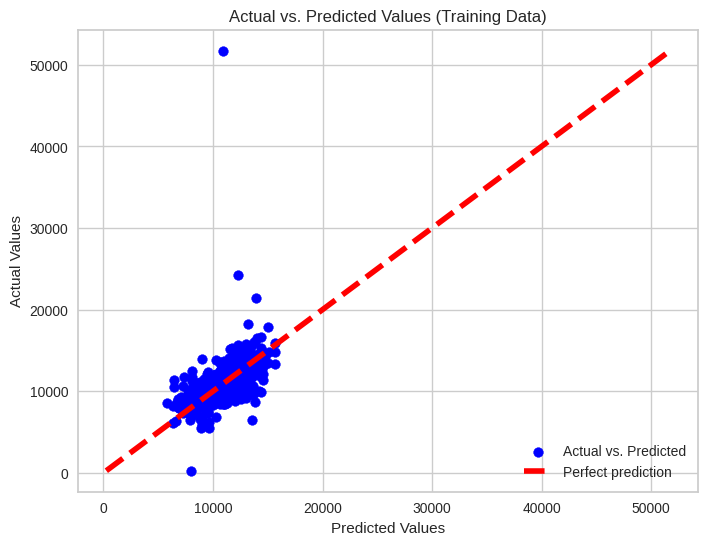

In [35]:
import matplotlib.pyplot as plt

# Plotting the predicted vs actual values for the training data
plt.figure(figsize=(8, 6))
plt.scatter(predictions_train, y_train, color='blue', label='Actual vs. Predicted')
plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=4, color='red', label='Perfect prediction')
plt.title('Actual vs. Predicted Values (Training Data)')
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')
plt.legend()
plt.grid(True)
plt.show()


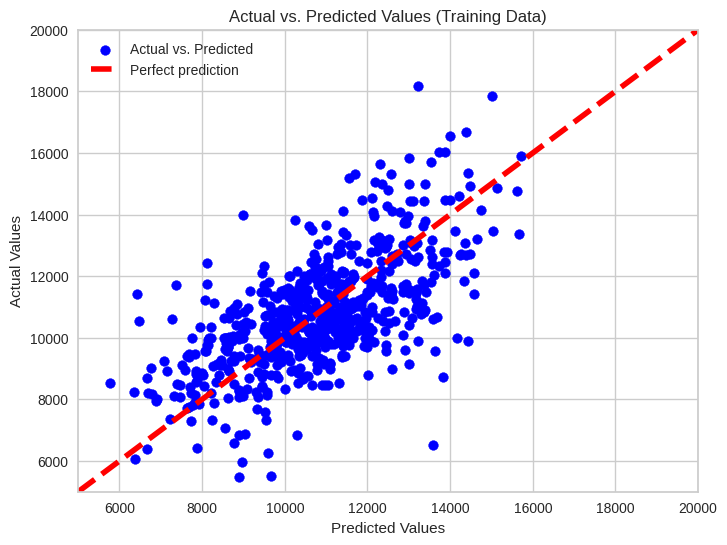

In [36]:
import matplotlib.pyplot as plt

# Plotting the predicted vs actual values for the training data
plt.figure(figsize=(8, 6))
plt.scatter(predictions_train, y_train, color='blue', label='Actual vs. Predicted')
plt.plot([5000, 20000], [5000, 20000], 'k--', lw=4, color='red', label='Perfect prediction')
plt.title('Actual vs. Predicted Values (Training Data)')
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')
plt.xlim(5000, 20000)
plt.ylim(5000, 20000)
plt.legend()
plt.grid(True)
plt.show()


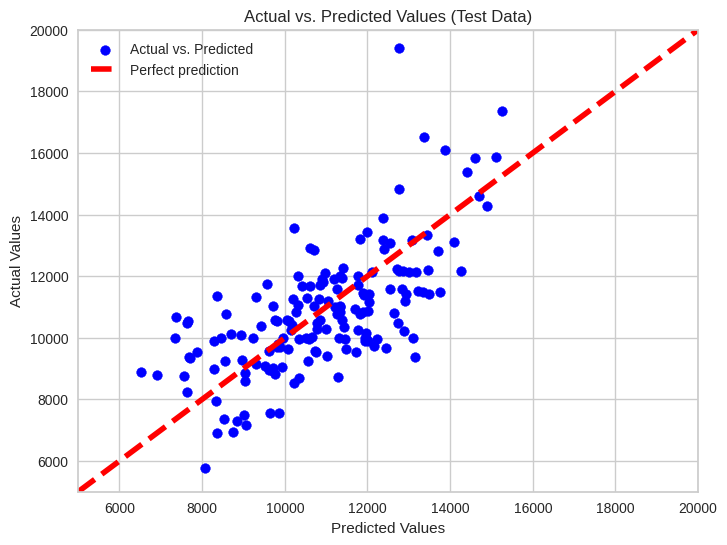

In [37]:
import matplotlib.pyplot as plt

# Plotting the predicted vs actual values for the test data
plt.figure(figsize=(8, 6))
plt.scatter(predictions_test, y_test, color='blue', label='Actual vs. Predicted')
plt.plot([5000, 20000], [5000, 20000], 'k--', lw=4, color='red', label='Perfect prediction')
plt.title('Actual vs. Predicted Values (Test Data)')
plt.xlabel('Predicted Values')
plt.ylabel('Actual Values')
plt.xlim(5000, 20000)
plt.ylim(5000, 20000)
plt.legend()
plt.grid(True)
plt.show()


## PyCaret

In [48]:
df=datac[features + [target]]

In [38]:
from pycaret.regression import *

In [49]:
# regression setup
reg_setup = setup(data=df, target='median_price_per_m2', train_size=0.8, normalize=True, preprocess=True, session_id=10)

# Compare
best_model = compare_models(fold=5, sort='R2')

# Finalize the best model
final_model = finalize_model(best_model)

# Evaluate
evaluate_model(final_model)

,Description,Value
0,Session id,10
1,Target,median_price_per_m2
2,Target type,Regression
3,Original data shape,"(817, 12)"
4,Transformed data shape,"(817, 12)"
5,Transformed train set shape,"(653, 12)"
6,Transformed test set shape,"(164, 12)"
7,Numeric features,11
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,973.7333,4463993.8010,1879.1235,0.4408,0.1739,0.1339,0.2860
huber,Huber Regressor,1023.3544,4526062.8491,1900.1818,0.4338,0.1743,0.1358,0.0680
lasso,Lasso Regression,1043.0243,4534942.6075,1902.2135,0.4323,0.1753,0.1378,0.0340
llar,Lasso Least Angle Regression,1043.0246,4534943.4288,1902.2128,0.4323,0.1753,0.1378,0.0640
lr,Linear Regression,1043.4459,4535574.3758,1902.3255,0.4322,0.1754,0.1378,1.1080
ridge,Ridge Regression,1043.3139,4535080.0921,1902.2981,0.4322,0.1753,0.1378,0.0440
lar,Least Angle Regression,1043.4459,4535574.3758,1902.3255,0.4322,0.1754,0.1378,0.0380
br,Bayesian Ridge,1043.4892,4540908.8879,1905.7527,0.4301,0.1752,0.1381,0.0580
par,Passive Aggressive Regressor,1020.7811,4531656.5846,1905.1390,0.4297,0.1743,0.1351,0.0640
lightgbm,Light Gradient Boosting Machine,1013.2195,4619257.6406,1919.8665,0.4208,0.1763,0.1331,0.8660


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [61]:
et = create_model('et')


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,839.6252,1635823.2937,1278.9931,0.6120,0.1015,0.0738
1,863.7031,1433120.8104,1197.1302,0.6433,0.1084,0.0821
2,980.0937,2616027.1729,1617.4137,0.3255,0.1333,0.0903
3,894.1027,3018620.0692,1737.4176,0.4019,0.1257,0.0757
4,769.1985,998678.7621,999.3392,0.7826,0.0883,0.0695
5,953.6477,2119790.7759,1455.9501,0.5557,0.4391,0.5504
6,1431.0867,26926327.7410,5189.0585,0.0879,0.2290,0.0943
7,1081.1159,2358134.9611,1535.6220,0.2159,0.1302,0.1044
8,947.7645,1993243.7539,1411.8228,0.5112,0.1407,0.0980


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [65]:
tuned_et = tune_model(et, n_iter=50, optimize = 'R2')


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,799.3890,1694788.1042,1301.8403,0.5980,0.1006,0.0688
1,910.8377,1609622.0493,1268.7088,0.5994,0.1125,0.0865
2,821.0792,1524613.2696,1234.7523,0.6069,0.1045,0.0738
3,830.5222,2860546.1624,1691.3149,0.4332,0.1205,0.0698
4,825.5616,1154393.8142,1074.4272,0.7487,0.0890,0.0710
5,914.8132,2098379.9194,1448.5786,0.5602,0.4411,0.5552
6,1500.0076,27283026.9440,5223.3157,0.0758,0.2331,0.1000
7,850.7942,1105980.1907,1051.6559,0.6322,0.1035,0.0853
8,935.2938,1817159.4558,1348.0206,0.5543,0.1356,0.0958


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


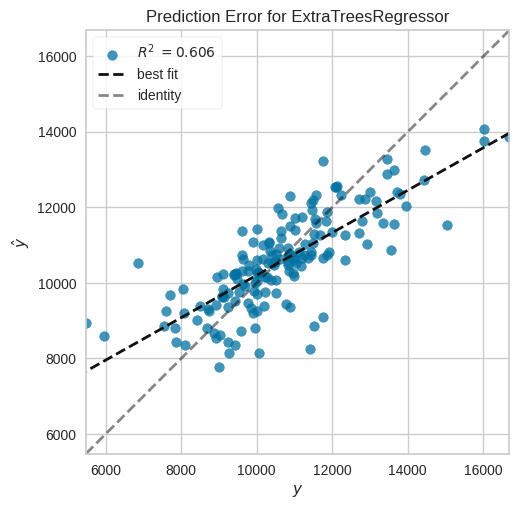

In [66]:
plot_model(tuned_et, plot = 'error')

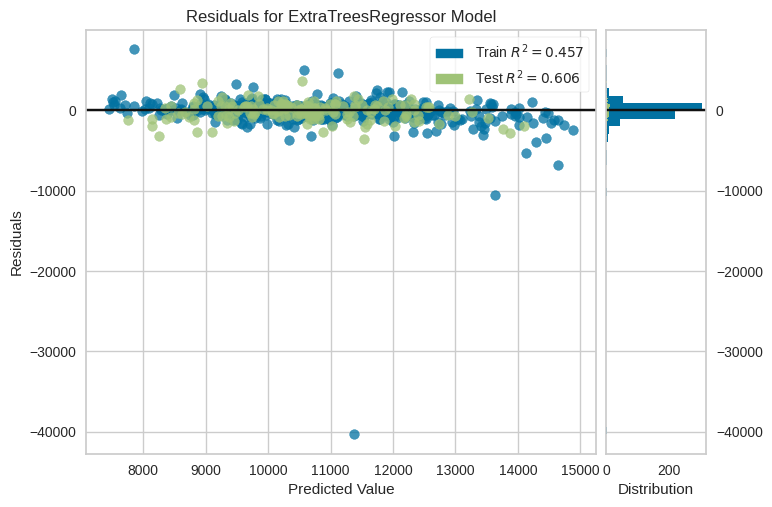

In [68]:
plot_model(tuned_et, plot = 'residuals')

In [69]:
plot_model(tuned_et, plot = 'tree')